## Whole Cell Gridding Code

This algorithm essentailly just looks at the outline of a cell as a "line" point by point

It then takes that "line" and creates squares normal to the contour on it

Then checks those against other squares for overlap and removes excessively overlapping ones


This currently just draws squares, but if that's possible it shouldn't be too complex to extract images from the defined squares

I think cv2.getPerspectiveTransform might be useful for that

This code largely hinges on the epithelium being/annotated in one continuous piece

In [3]:
import numpy as np
import cv2
import matplotlib.pyplot as plt


#Read image and threshold for mask:
#This basic method works best with already cropped cells
#I have another at the bottom that is slightly better for cells with backgrounds
image1=cv2.imread("testing_slices/h2114153  h&e_ROI_1 Epithelia.png")
image1_gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
_,whole_thresh=cv2.threshold(image1_gray,1,255,cv2.THRESH_BINARY)


## Finding contours

It is designed to take in a cell that has been seperated from the background. The mask/thresh should have clear lines for a contour to be drawn along

In [4]:
def find_largest_countour(binary_image):
    """Calulate the largest vector in a binary image-typically the outline"""
    contours, _=cv2.findContours(binary_image,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    return max(contours,key=cv2.contourArea)

In [5]:
def find_second_largest_countour(binary_image):
    """Calculate the second largest vector in binary image (should be the inner layer)"""
    contours, _ = cv2.findContours(binary_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)
    return contours[1]

## Calculations

##### Contour normals

In [6]:
def calculate_contour_tangents(contour,smooting_size=5):
    """
    Calculate tangent vectors across the contour
    """
    #The normal vector is parallel to contour at a point and ensures the square goes in to the cell
    #Smoothing size is how many points before and after current to look back and find tangent

    #Reshape contour into (x,y) pairings
    points=contour.reshape(-1,2)
    n_points=len(points)
    tangents=np.zeros_like(points,dtype=float)

    for i in range(n_points):
        #get indices, % handles wraparound
        prev_idx=(i-smooting_size)%n_points
        next_idx=(i+smooting_size)%n_points
        tangent=points[next_idx]-points[prev_idx]

        tangents[i]=tangent

    return tangents

##### Square corners

In [7]:
# Take one
def calculate_square_corners(point,tangent, inner_contour, square_size):
    """Calculate square corners so that top edge is touching the contour point"""
    unit_tangent = tangent / np.linalg.norm(tangent + 1e-10)
    inner_points = inner_contour.reshape(-1, 2)

    # Calculate normal vector and make sure it is pointing inwards towards the inner contour. If not then reverse it
    normal_vector = np.array([-unit_tangent[1], unit_tangent[0]])
    distances = np.linalg.norm(inner_points - point, axis = 1)
    min_dist_index = np.argmin(distances)
    closest_point = inner_points[min_dist_index]
    closest_vector = closest_point - point
    if np.dot(normal_vector, closest_vector) / (np.linalg.norm(normal_vector) * np.linalg.norm(closest_vector)) < 0.5:
        normal_vector = -normal_vector

    ####################################
    # Calculate closest point in inner contour array and make vector between the two.
    # Find the distance of that vector and make that the square width/height
    # Create square based on normal vector of tangent
    distance = distances[min_dist_index]
    half_size = distance/2
    unit_normal = normal_vector / np.linalg.norm(normal_vector + 1e-10)
    ###################################



    #Take point and extend from it in tangent and normal directions
    #Normalization allows for multiplication by square size
    corners=np.array([
        point+(unit_tangent*half_size),
        point-(unit_tangent*half_size),
        point-(unit_tangent*half_size)+(unit_normal*distance),
        point+(unit_tangent*half_size)+(unit_normal*distance)
    ])
    return corners

In [8]:
# Take two, only checks the closest point on the inner contour and then leaves it at that
def calculate_square_corners(point,tangent, inner_contour, square_size):
    """Calculate square corners so that top edge is touching the contour point"""
    inner_points = inner_contour.reshape(-1, 2)

    # Calculate normal vector and make sure it is pointing inwards towards the inner contour. If not then reverse it
    distances = np.linalg.norm(inner_points - point, axis = 1)
    min_dist_index = np.argmin(distances)
    closest_point = inner_points[min_dist_index]
    normal_vector = closest_point - point

    tangent_vector = np.array([-normal_vector[1], normal_vector[0]])
    unit_tangent = tangent_vector / np.linalg.norm(tangent_vector + 1e-10)

    ####################################
    # Calculate closest point in inner contour array and make vector between the two.
    # Find the distance of that vector and make that the square width/height
    # Create square based on normal vector of tangent
    distance = distances[min_dist_index]
    half_size = distance/2
    unit_normal = normal_vector / np.linalg.norm(normal_vector + 1e-10)
    ###################################



    #Take point and extend from it in tangent and normal directions
    #Normalization allows for multiplication by square size
    corners=np.array([
        point+(unit_tangent*half_size),
        point-(unit_tangent*half_size),
        point-(unit_tangent*half_size)+(unit_normal*distance),
        point+(unit_tangent*half_size)+(unit_normal*distance)
    ])
    return corners

##### Overlap area This is unused in my version

In [9]:
def calculate_overlap_area(square1,square2):
    """
    Calculate approx overlap between two squares
    Return ovelap area and center-center dist
    """
    #Average x and y to find center
    center1=np.mean(square1,axis=0)
    center2=np.mean(square2,axis=0)
    distance=np.linalg.norm(center1-center2)

    #Calculate the diagonal distance of the first square (using opposite corners)
    diagonal=np.linalg.norm(square1[0]-square1[2])
    #Rudimentary distance calculation, how much of the distance could be explained by overlapping diagonals
    overlap=max(0,1-(distance/diagonal))

    return overlap,distance

## Creation

In [10]:
def create_dense_squares(contour, second_contour, normals,square_size=64,step=5):
    """Create dense squares along the contour"""
    points=contour.reshape(-1,2)
    n_points=len(points)
    squares=[]
    indices=[]

    #Create squares at intervals
    for i in range(0,n_points,step):
        corners=calculate_square_corners(points[i],normals[i], second_contour,square_size)
        squares.append(corners)
        indices.append(i)

    return squares,indices

## Remove overlap

In [17]:
def remove_overlapping_squares(squares, indices, base_image, overlap_thresh=0.3, count = 1):
    '''
    Naive method to remove overlapping squares, start adding squares if the overlap area with the previous patch is
    less than the overlap threshold. Returns multiple different possible patch positions. If the current patch
    is more than "base amount" black space, remove square
    '''   
    if count == 2:
        return
    if not squares:
      return [],[]

    return_square = [squares[0]]
    return_indices = [indices[0]]
    leftover_square = []
    leftover_indices = []

    n_squares = len(squares)

    # Put in first square
    square1 = cv2.fillPoly(np.zeros(base_image.shape), [squares[0].astype('int32')], color = (255, 255, 255))
    current_mask = np.logical_and(base_image, square1)

    # Iterate through squares, and add them to return_square if they can be added, and left_over_square if they cannot
    for i in range(1, n_squares):
        squarei = cv2.fillPoly(np.zeros(base_image.shape), [squares[i].astype('int32')], color = (255, 255, 255))
        image_mask = np.logical_and(base_image, squarei)
        mask_overlap = np.logical_and(current_mask, squarei)

        # Find if you can add the current square to the current mask
        if mask_overlap.sum() / image_mask.sum() < overlap_thresh:
            current_mask = np.logical_or(current_mask, squarei)
            return_square.append(squares[i])
            return_indices.append(indices[i])

        else:
            leftover_square.append(squares[i])
            leftover_indices.append(indices[i])
            
    # In case you still want to repeat the process with the leftovers, to create more versions of the patches
    #new_squares, new_indices = remove_overlapping_squares(leftover_square, leftover_indices, base_image, overlap_thresh, count + 1)
        
    return return_square, return_indices

## Draw image

In [12]:
def draw_image_squares(image,squares,color=(255,0,0),thickness=20):
    """"Draw kept squares on image"""
    grid_img=image.copy()

    for square in squares:
        points=square.astype(np.int32)
        cv2.polylines(
            grid_img,
            [points],
            isClosed=True,
            color=color,
            thickness=thickness
        )
    return grid_img

## Main function

In [13]:
def normal_squares_from_contour(image,binary_image,square_size=64,step=5,overlap_thresh=0.3,smoothing_size=5):
    """
    Main function to find normals and tangents of contour and create corresponding squares

    Args:
        image: Original Image
        binary_mask: Binary mask of main shape
        square_size:Desired size of squares
        step: points to skip between initial dense squares drawing
        overlap_threshold:Max allowed overlap between squares (0-1)
        smoothing_size:# of Points considered before and after when creating normals

    """

    contour=find_largest_countour(binary_image)
    second_contour = find_second_largest_countour(binary_image)
    normals=calculate_contour_tangents(contour,smooting_size=smoothing_size)

    #Create initial squares
    squares, indices=create_dense_squares(contour, second_contour, normals,square_size=square_size,step=step)

    #Remove overlapping
    final_squares,final_indices=remove_overlapping_squares(squares,indices,binary_image, overlap_thresh=overlap_thresh)
    print('len of final_squares', len(final_squares))
    print('len of final_indices', len(final_indices))

    grid_img=draw_image_squares(image,final_squares)

    #Plot image and contour
    plt.imshow(grid_img)
    plt.plot(contour[:,0,0],contour[:,0,1],'r',alpha=0.5,label='Contour')

    return grid_img,contour,squares

def extract_square_images(image, squares):
    """
    Extract image patches corresponding to the squares.

    Args:
        image: Original image (numpy array)
        squares: List of square corners (each is a 4x2 numpy array)

    Returns:
        List of cropped image patches.
    """
    patches = []
    for square in squares:
        # Get corners for the square
        x_min = max(int(np.min(square[:, 0])), 0)
        x_max = min(int(np.max(square[:, 0])), image.shape[1])
        y_min = max(int(np.min(square[:, 1])), 0)
        y_max = min(int(np.max(square[:, 1])), image.shape[0])

        # Crop the patch
        patch = image[y_min:y_max, x_min:x_max]
        patches.append(patch)

    return patches


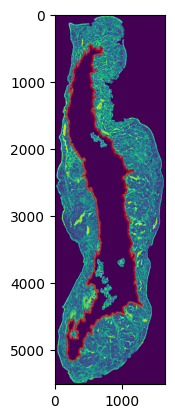

In [14]:
sec = find_second_largest_countour(image1_gray)
plt.imshow(image1_gray)
plt.plot(sec[:,:,0], sec[:,:,1], 'r', alpha = 0.5, label = 'Contour')

len of final_squares 52
len of final_indices 52


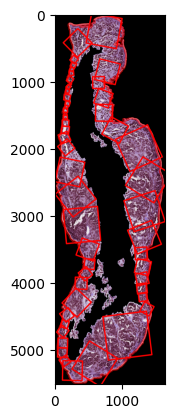

In [15]:
result_image, contour, squares = normal_squares_from_contour(
     image1,
     whole_thresh,
     square_size=256,
     step=5,
     overlap_thresh=0.1,
     smoothing_size=2
 )

Save to geopandas geodataframe:
- create pd dataframe
- columns: patient ID, top_left_x, top_left_y, bottom_right_x, bottom_right_y, classification
- convert to gpd.GeoDataFrame

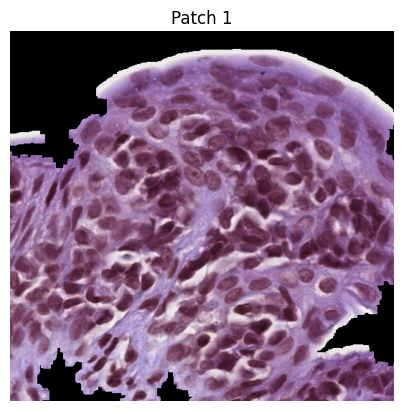

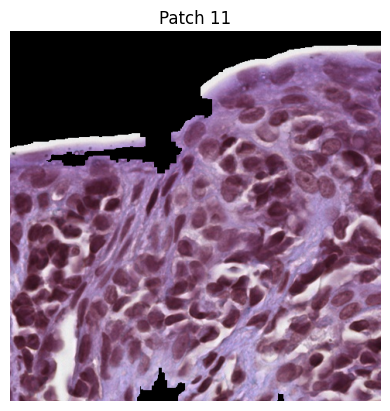

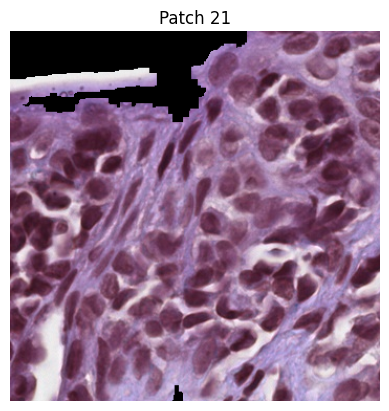

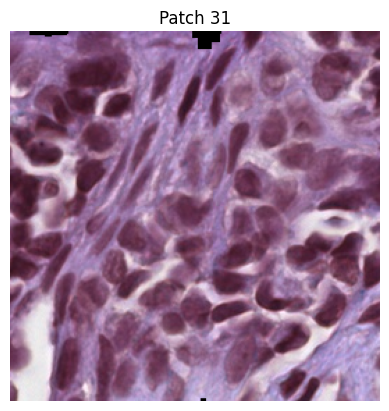

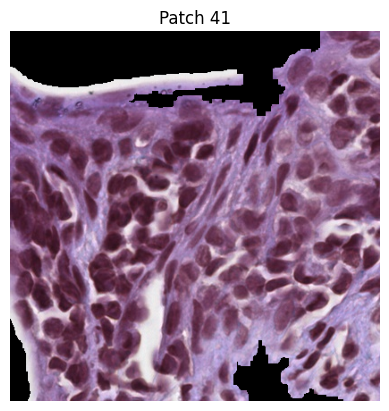

...

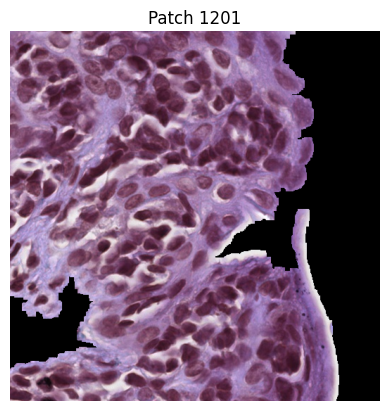

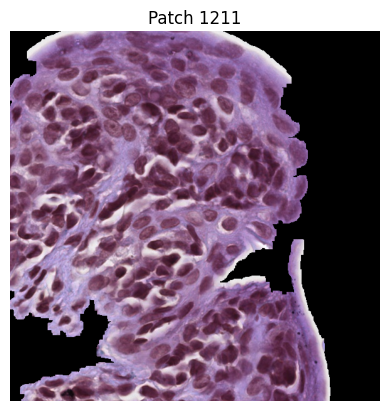

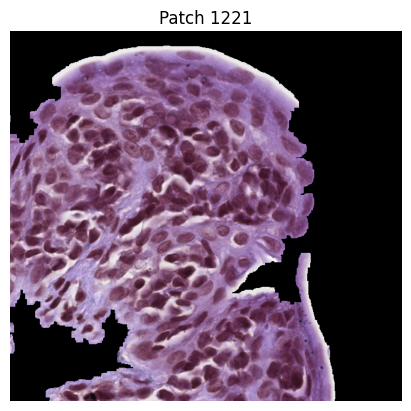

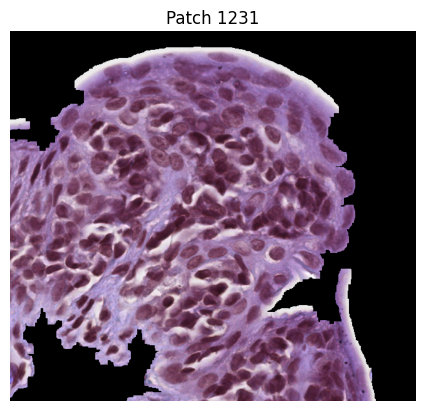

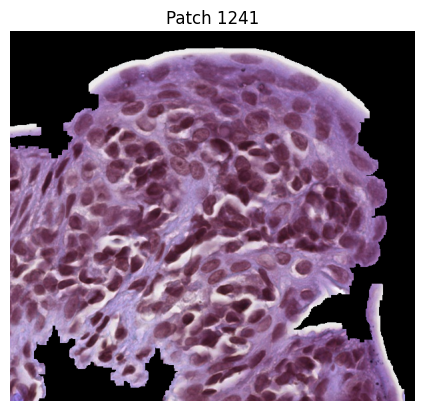

In [16]:
# Extract the image patches corresponding to the squares
patches = extract_square_images(image1, squares)

# Display or save the patches
for i, patch in enumerate(patches):
    if i % 10 == 0:
        plt.figure()
        plt.imshow(patch, cmap='gray')
        plt.title(f"Patch {i + 1}")
        plt.axis('off')
        plt.show()

### Below is a basic approach to thresholding and masking an image that still has its white background


```python
image1_gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
_,whole_thresh=cv2.threshold(image1_gray,200,255,cv2.THRESH_BINARY)#+cv2.THRESH_OTSU)
whole_thresh_inv=cv2.bitwise_not(whole_thresh)
whole_thresh=whole_thresh_inv
plt.imshow(whole_thresh_inv,cmap='gray')
```